<a href="https://colab.research.google.com/github/arlenkim/study/blob/main/Sound_vibration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
from scipy.io import wavfile
from scipy import signal
import numpy as np
from matplotlib import pyplot as plt
import os
import librosa.display, librosa
import IPython.display
import warnings
from IPython.display import Audio
warnings.simplefilter("ignore")

In [7]:
sv = r'/content/drive/MyDrive/Colab Notebooks/sv2.wav'
(file_dir, file_id) = os.path.split(sv)

print("Path : ", file_dir)
print("Name : ", file_id)

Path :  /content/drive/MyDrive/Colab Notebooks
Name :  sv2.wav


In [8]:
y, sr = librosa.load('/content/drive/MyDrive/ColabNotebooks/sv2.wav', duration=57, offset=0)

Audio(data=y, rate=sr)

In [9]:
y1, sr = librosa.load('/content/drive/MyDrive/ColabNotebooks/SV.wav', duration=57, offset=0)

Audio(data=y1, rate=sr)

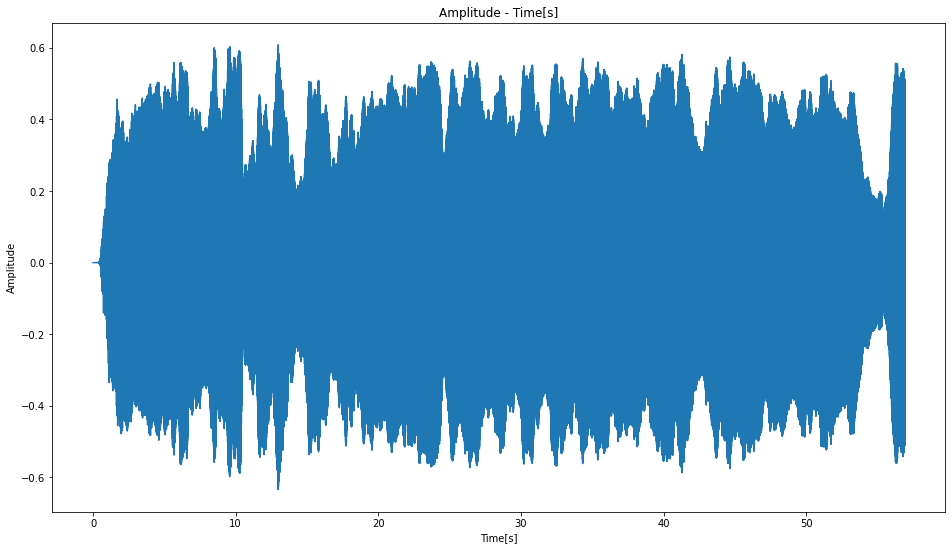

In [10]:
time = np.linspace(0, len(y)/sr, len(y))

plt.figure(figsize=(16,9))
plt.plot(time, y)
plt.ylabel("Amplitude")
plt.xlabel("Time[s]")
plt.title("Amplitude - Time[s]")
plt.show()

(0.0, 1100.0)

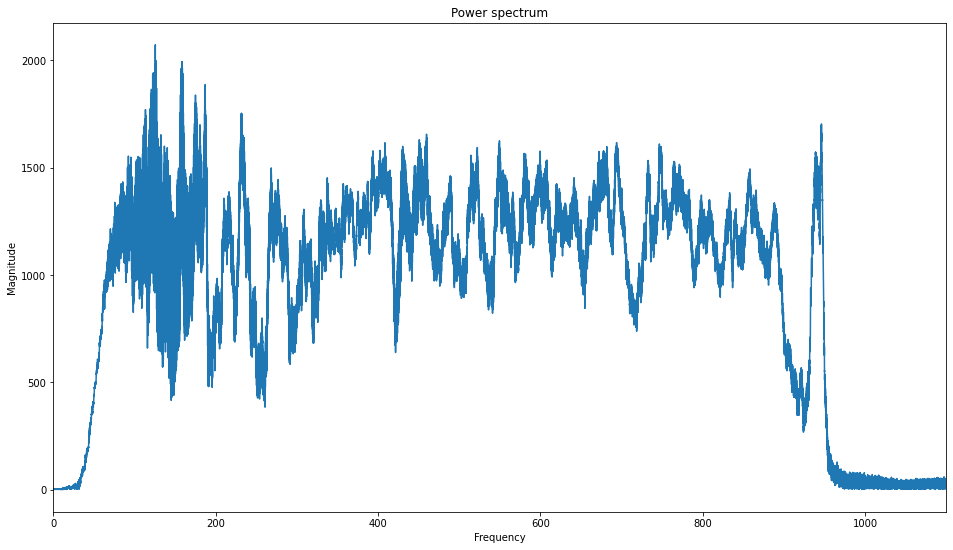

In [11]:
fft = np.fft.fft(y)

magnitude = np.abs(fft) 

f = np.linspace(0, sr, len(magnitude))
left_spectrum = magnitude[:int(len(magnitude)/2)]
left_f = f[:int(len(magnitude)/2)]

plt.figure(figsize=(16,9))
plt.plot(left_f, left_spectrum)
plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.title("Power spectrum")
plt.xlim(0,1100)

In [12]:
D = librosa.stft(y)

In [13]:
D_harmonic, D_percussive = librosa.decompose.hpss(D)

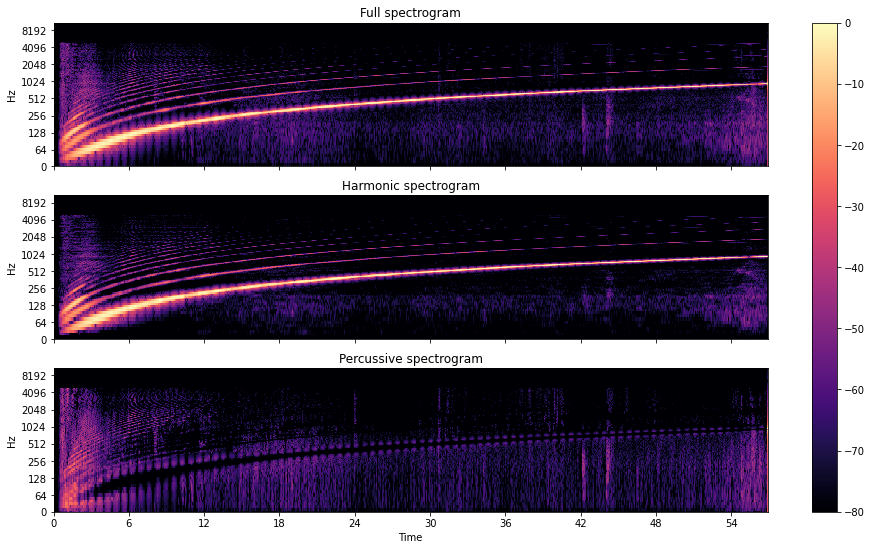

In [14]:
# Pre-compute a global reference power from the input spectrum
rp = np.max(np.abs(D))

fig, ax = plt.subplots(nrows=3, sharex=True, sharey=True,figsize=(16, 9))

img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(D), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Full spectrogram')
ax[0].label_outer()

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_harmonic), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[1])
ax[1].set(title='Harmonic spectrogram')
ax[1].label_outer()

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_percussive), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[2])
ax[2].set(title='Percussive spectrogram')
fig.colorbar(img, ax=ax)



In [15]:
y_harmonic = librosa.istft(D_harmonic, length=len(y))
Audio(data=y_harmonic, rate=sr)

In [16]:
y_percussive = librosa.istft(D_percussive, length=len(y))
Audio(data=y_percussive, rate=sr)

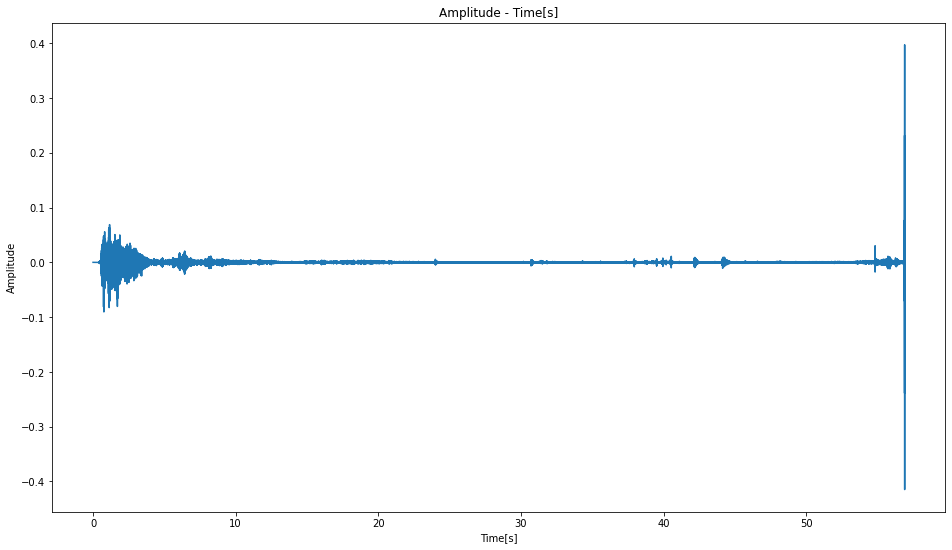

In [17]:
time = np.linspace(0, len(y_percussive)/sr, len(y_percussive))

plt.figure(figsize=(16,9))
plt.plot(time, y_percussive)
plt.ylabel("Amplitude")
plt.xlabel("Time[s]")
plt.title("Amplitude - Time[s]")
plt.show()

(0.0, 1100.0)

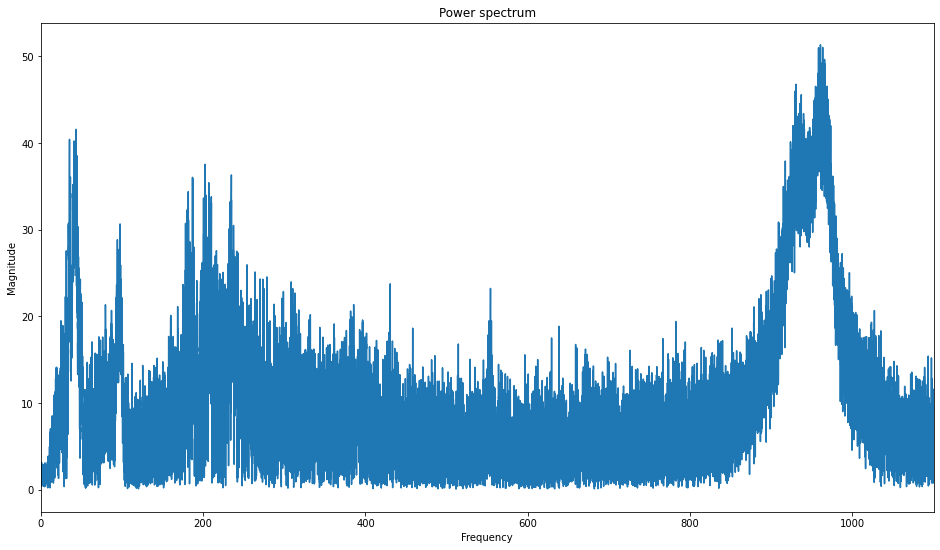

In [18]:
fft = np.fft.fft(y_percussive)

magnitude = np.abs(fft) 

f = np.linspace(0, sr, len(magnitude))
left_spectrum = magnitude[:int(len(magnitude)/2)]
left_f = f[:int(len(magnitude)/2)]

plt.figure(figsize=(16,9))
plt.plot(left_f, left_spectrum)
plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.title("Power spectrum")
plt.xlim(0,1100)

In [19]:
np.set_printoptions(precision=2, suppress=True)


In [20]:
import pandas as pd

In [21]:
left_f

array([    0.  ,     0.02,     0.04, ..., 11024.95, 11024.96, 11024.98])

In [22]:
arr4 = np.stack((left_f, left_spectrum), axis=1)
print(arr4)

[[    0.       1.99]
 [    0.02     2.16]
 [    0.04     2.14]
 ...
 [11024.95     0.03]
 [11024.96     0.03]
 [11024.98     0.03]]


In [23]:
arr5 = np.round(arr4, 0)
print(arr5)

[[    0.     2.]
 [    0.     2.]
 [    0.     2.]
 ...
 [11025.     0.]
 [11025.     0.]
 [11025.     0.]]


In [24]:
DF = pd.DataFrame(arr5)
DF

,0,1
0,0.0,2.0
1,0.0,2.0
2,0.0,2.0
3,0.0,2.0
4,0.0,3.0
...,...,...
627273,11025.0,0.0
627274,11025.0,0.0
627275,11025.0,0.0
627276,11025.0,0.0


In [25]:
DF.columns = ['left_f','left_spectrum']
DF

,left_f,left_spectrum
0,0.0,2.0
1,0.0,2.0
2,0.0,2.0
3,0.0,2.0
4,0.0,3.0
...,...,...
627273,11025.0,0.0
627274,11025.0,0.0
627275,11025.0,0.0
627276,11025.0,0.0


In [26]:
DF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 627278 entries, 0 to 627277
Data columns (total 2 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   left_f         627278 non-null  float64
 1   left_spectrum  627278 non-null  float64
dtypes: float64(2)
memory usage: 9.6 MB


In [27]:
DF2=DF.loc[DF.left_f < 1000,['left_f','left_spectrum']]
DF2

,left_f,left_spectrum
0,0.0,2.0
1,0.0,2.0
2,0.0,2.0
3,0.0,2.0
4,0.0,3.0
...,...,...
56863,999.0,13.0
56864,999.0,15.0
56865,999.0,15.0
56866,999.0,15.0


In [28]:
DF3=DF2.loc[DF2.left_f == 0,['left_f','left_spectrum']]
DF3

,left_f,left_spectrum
0,0.0,2.0
1,0.0,2.0
2,0.0,2.0
3,0.0,2.0
4,0.0,3.0
5,0.0,3.0
6,0.0,3.0
7,0.0,3.0
8,0.0,3.0
9,0.0,3.0


In [29]:
DF4=DF2.drop_duplicates(['left_f'], ignore_index = True)

In [30]:
DF4.shape[0]
DF4


,left_f,left_spectrum
0,0.0,2.0
1,1.0,1.0
2,2.0,2.0
3,3.0,3.0
4,4.0,3.0
...,...,...
995,995.0,14.0
996,996.0,16.0
997,997.0,17.0
998,998.0,16.0


In [48]:
DF5=DF4.loc[DF4.left_f % 3 == 0,['left_f','left_spectrum']]
DF5=DF5.reset_index(drop=True)
DF5

,left_f,left_spectrum
0,0.0,2.0
1,3.0,3.0
2,6.0,1.0
3,9.0,1.0
4,12.0,4.0
...,...,...
329,987.0,21.0
330,990.0,16.0
331,993.0,21.0
332,996.0,16.0


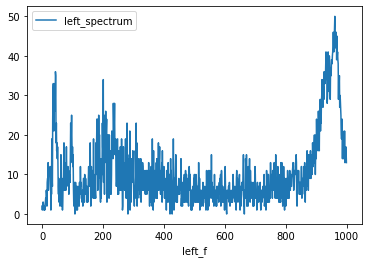

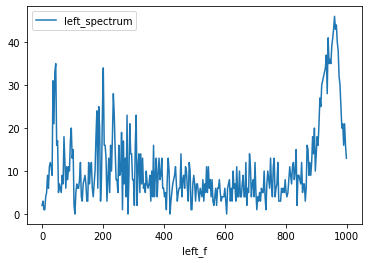

In [49]:
DF4.plot(x="left_f", y="left_spectrum")
DF5.plot(x="left_f", y="left_spectrum")

NameError: ignored

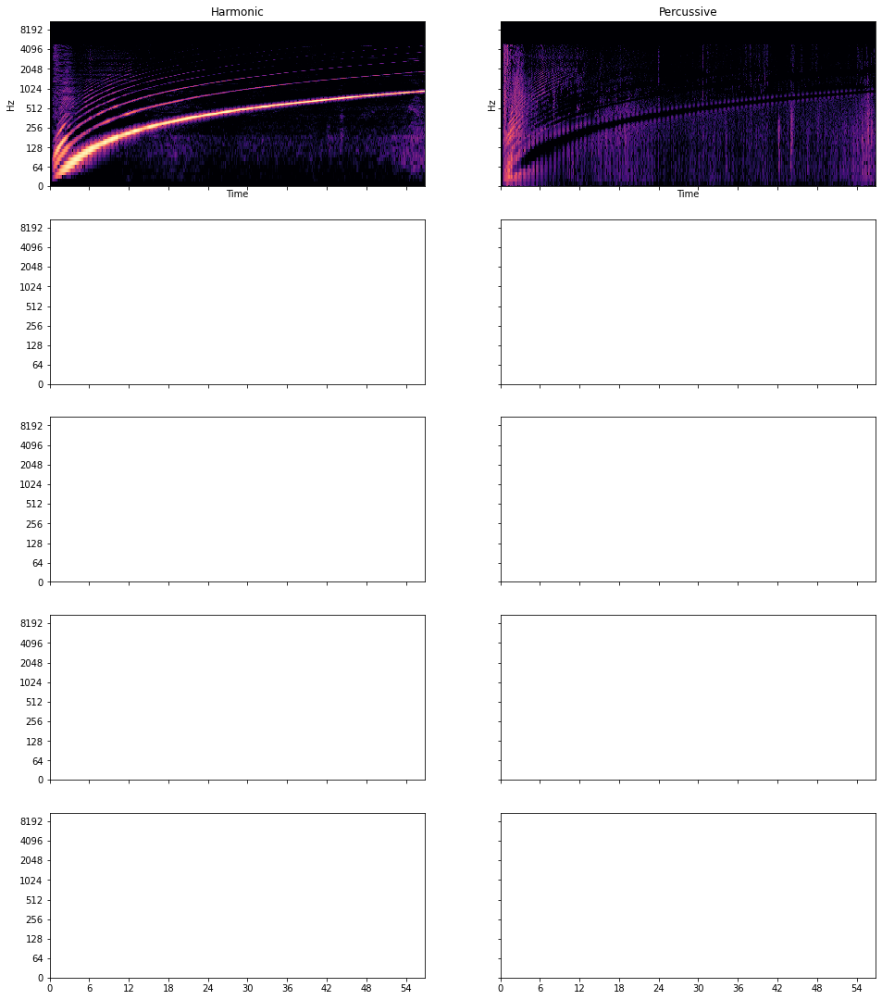

In [33]:
fig, ax = plt.subplots(nrows=5, ncols=2, sharex=True, sharey=True, figsize=(16, 19))
librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_harmonic), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[0, 0])
ax[0, 0].set(title='Harmonic')

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_percussive), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[0, 1])
ax[0, 1].set(title='Percussive')

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_harmonic2), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[1, 0])

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_percussive2), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[1, 1])

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_harmonic4), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[2, 0])

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_percussive4), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[2, 1])

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_harmonic8), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[3, 0])

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_percussive8), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[3, 1])

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_harmonic16), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[4, 0])

librosa.display.specshow(librosa.amplitude_to_db(np.abs(D_percussive16), ref=rp),
                         y_axis='log', x_axis='time', ax=ax[4, 1])

for i in range(5):
    ax[i, 0].set(ylabel='margin={:d}'.format(2**i))
    ax[i, 0].label_outer()
    ax[i, 1].label_outer()

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/ColabNotebooks/sv2.wav', duration=57, offset=0)

Audio(data=y, rate=sr)

In [ ]:
y_harmonic2 = librosa.istft(D_harmonic2, length=len(y))
Audio(data=y_harmonic2, rate=sr)

In [ ]:
y_percussive = librosa.istft(D_percussive, length=len(y))
Audio(data=y_percussive, rate=sr)

In [ ]:
y_percussive2 = librosa.istft(D_percussive2, length=len(y))
Audio(data=y_percussive2, rate=sr)

In [ ]:
y_percussive4 = librosa.istft(D_percussive4, length=len(y))
Audio(data=y_percussive4, rate=sr)

In [ ]:
y_percussive8 = librosa.istft(D_percussive8, length=len(y))
Audio(data=y_percussive8, rate=sr)